Import das dependências necessárias

In [1]:
# Common
import os 
import keras
import numpy as np 
import pandas as pd
from glob import glob
import tensorflow as tf
from IPython.display import clear_output as cls

# Data 
from tensorflow.keras.utils import load_img, img_to_array
from keras.preprocessing.image import ImageDataGenerator

# Data Visualization
import plotly.express as px
import matplotlib.pyplot as plt

# Model 
from keras.models import Sequential, load_model
from keras.layers import GlobalAvgPool2D as GAP, Dense, Dropout

# Callbacks 
from keras.callbacks import EarlyStopping, ModelCheckpoint

# Pre-Trained Model
from tensorflow.keras.applications import ResNet50V2

In [2]:
# Class Names
root_path = 'S:/Desktop/TrainingAnimalClassification/data/Training_Data/'
class_names = sorted(os.listdir(root_path))
n_classes = len(class_names)

# Class Distribution
class_dis = [len(os.listdir(root_path + name)) for name in class_names]


# Show
print(f"Total Number of Classes : {n_classes} \nClass Names : {class_names}")

FileNotFoundError: [WinError 3] O sistema não pode encontrar o caminho especificado: 'S:/Desktop/TrainingAnimalClassification/data/Training_Data/'

In [10]:
# Visualize 
fig = px.pie(names=class_names, values=class_dis, title="Training Class Distribution", hole=0.4)
fig.update_layout({'title':{'x':0.48}})
fig.show()

In [4]:
# Visualize 
fig = px.bar(x=class_names, y=class_dis, title="Training Class Distribution", color=class_names)
fig.update_layout({'title':{'x':0.48}})
fig.show()

In [5]:
# Class Names
valid_path = 'S:/Desktop/TrainingAnimalClassification/data/Validation_Data/'

# Class Distribution
class_dis = [len(os.listdir(valid_path + name)) for name in class_names]

# Pie
# fig = px.pie(names=class_names, values=class_dis, title="Validation Class Distribution", color=class_names, hole=0.2)
# fig.update_layout({'title':{'x':0.5}})
# fig.show()

# # Visualize 
# fig = px.bar(x=class_names, y=class_dis, color=class_names)
# fig.show()

In [6]:
# Class Names
test_path = 'S:/Desktop/TrainingAnimalClassification/data/Testing_Data/'

# Class Distribution
class_dis = [len(os.listdir(test_path + name)) for name in class_names]

# Pie
fig = px.pie(names=class_names, values=class_dis, title="Testing Class Distribution", color=class_names, hole=0.2)
fig.update_layout({'title':{'x':0.48}})
fig.show()

# Visualize 
fig = px.bar(x=class_names, y=class_dis, color=class_names)
fig.show()

In [7]:
# Initialize Generator
train_gen = ImageDataGenerator(
    rescale=1/255.,
    rotation_range=10,
    horizontal_flip=True,
    shear_range=0.2,
    zoom_range=0.2,
    width_shift_range=0.2,
    height_shift_range=0.2,
    brightness_range=[0.8, 1.2],
    channel_shift_range=20,
)

valid_gen = ImageDataGenerator(rescale=1/255.)
test_gen = ImageDataGenerator(rescale=1/255)

# Load Data
train_ds = train_gen.flow_from_directory(
    root_path, class_mode='binary', target_size=(256, 256), shuffle=True, batch_size=32)
valid_ds = valid_gen.flow_from_directory(
    valid_path, class_mode='binary', target_size=(256, 256), shuffle=True, batch_size=32)
test_ds = test_gen.flow_from_directory(
    test_path, class_mode='binary', target_size=(256, 256), shuffle=True, batch_size=32)


Found 30000 images belonging to 15 classes.
Found 2000 images belonging to 15 classes.
Found 2407 images belonging to 15 classes.


In [11]:
def show_images(GRID=[5,5], model=None, size=(20,20), data=train_ds):
    n_rows = GRID[0]
    n_cols = GRID[1]
    n_images = n_cols * n_rows
    
    i = 1
    plt.figure(figsize=size)
    for images, labels in data:
        id = np.random.randint(len(images))
        image, label = images[id], class_names[int(labels[id])]
        
        plt.subplot(n_rows, n_cols, i)
        plt.imshow(image)
        
        if model is None:
            title = f"Class : {label}"
        else:
            pred = class_names[int(np.argmax(model.predict(image[np.newaxis, ...])))]
            title = f"Org : {label}, Pred : {pred}"
            cls()
        
        plt.title(title)
        plt.axis('off')
        
        i+=1
        if i>=(n_images+1):
            break
            
    plt.tight_layout()
    plt.show()

In [12]:
def load_image(path):
    '''This function will load the image present at the given location'''
    image = tf.cast(tf.image.resize(img_to_array(load_img(path))/255., (256,256)), tf.float32)
    return image
def show_image(image, title=None):
    plt.imshow(image)
    plt.axis('off')
    plt.title(title)

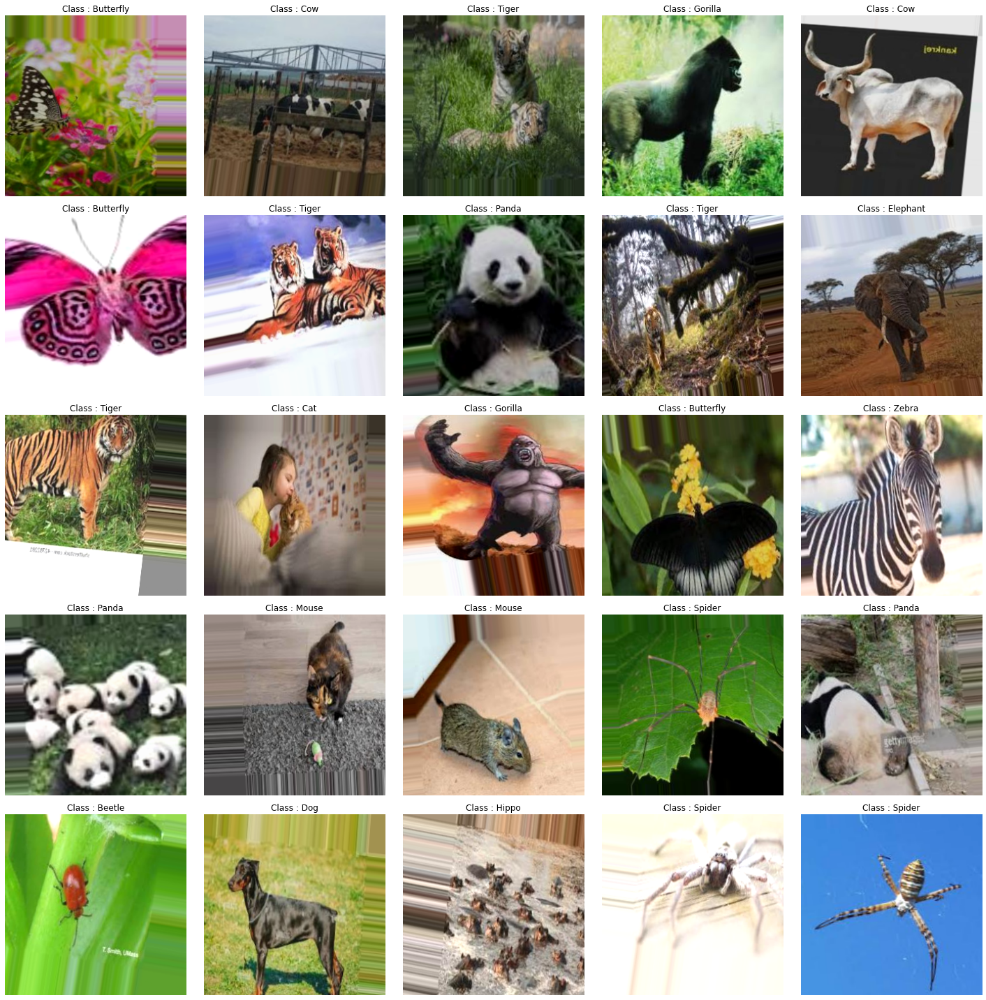

In [12]:
show_images(data=train_ds)

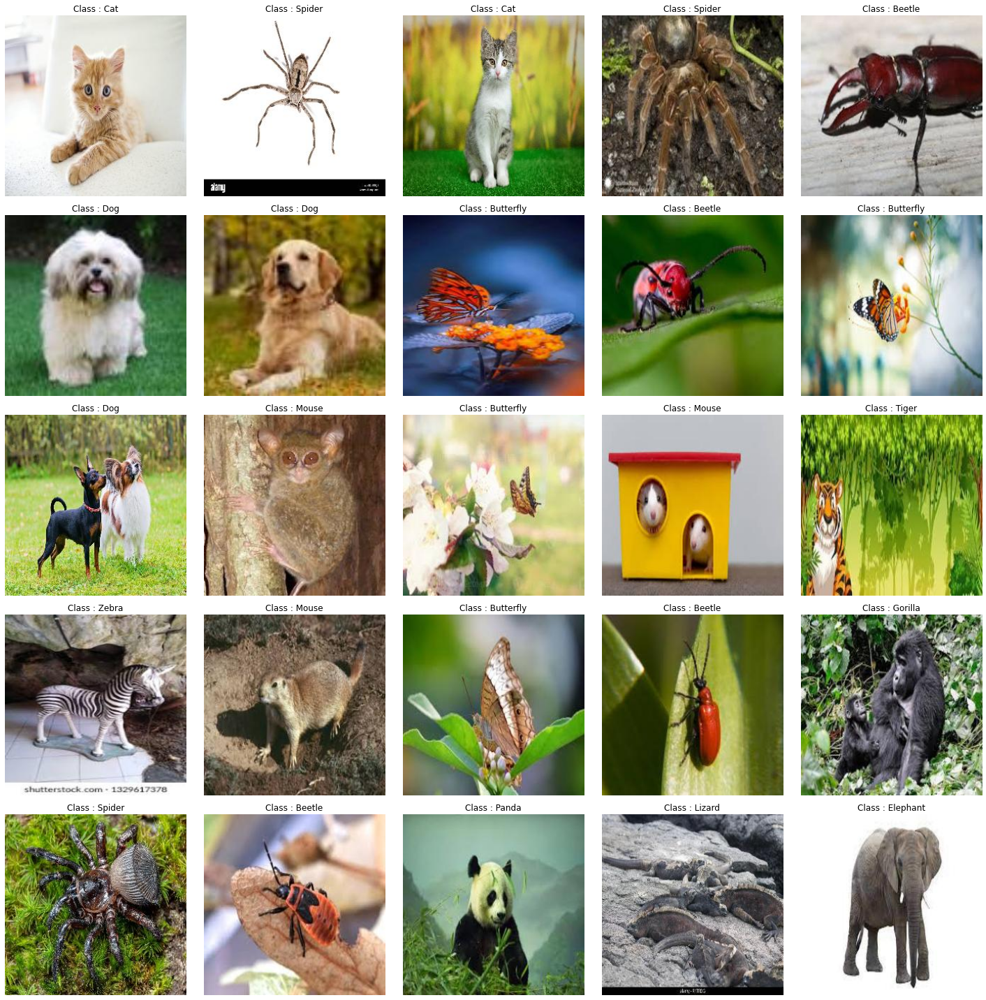

In [13]:
show_images(data=valid_ds)

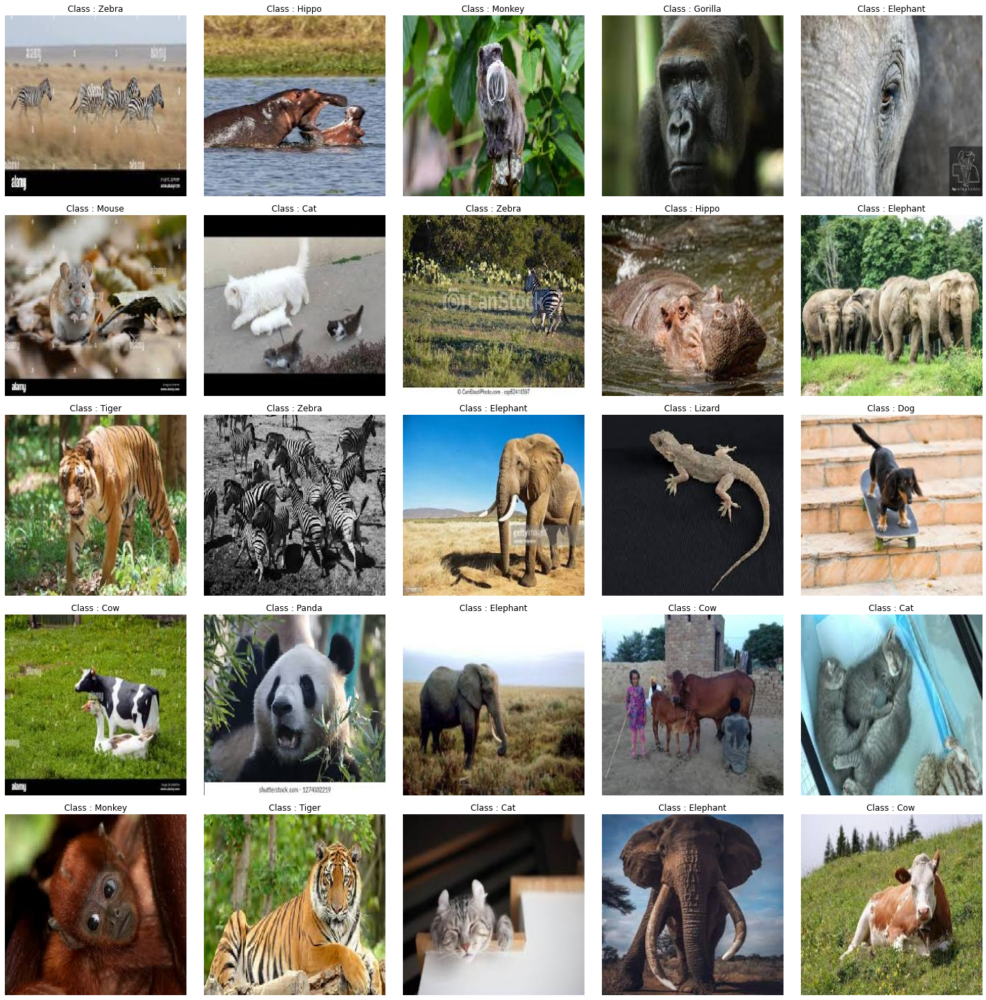

In [14]:
show_images(data=test_ds)

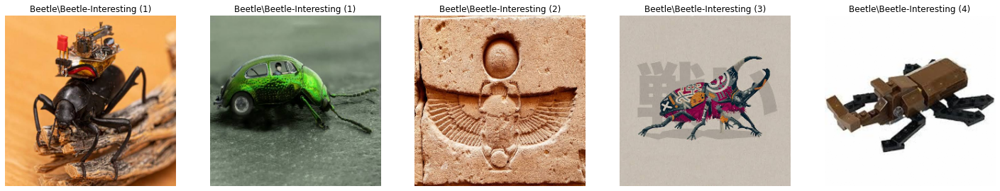

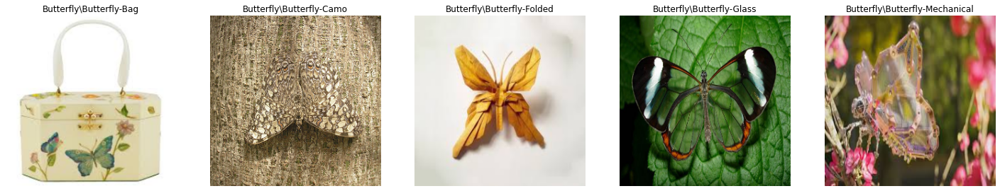

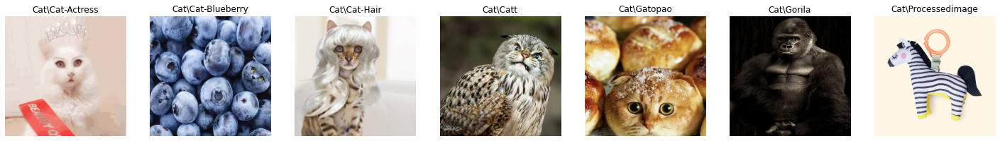

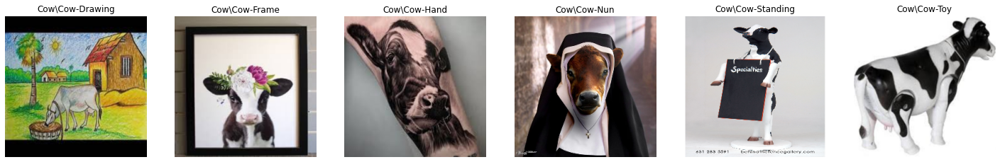

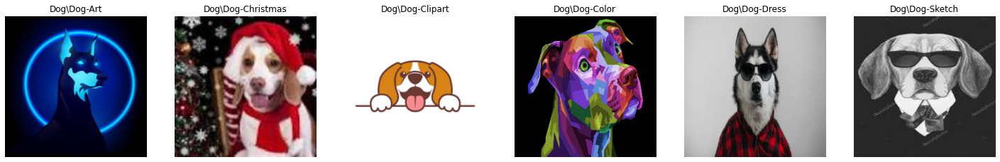

...

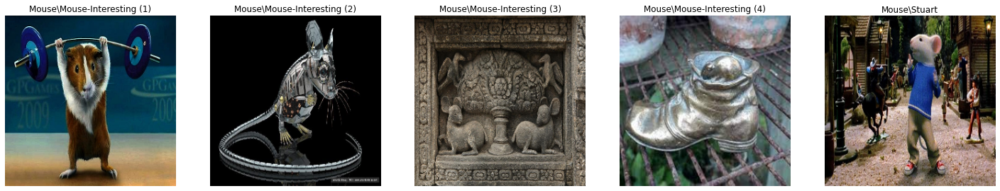

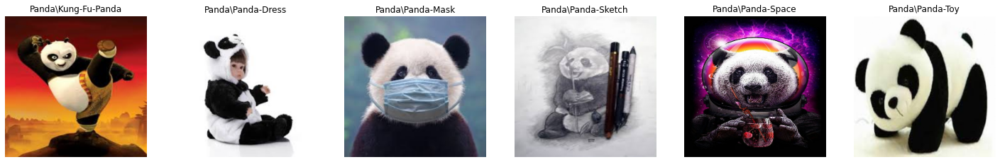

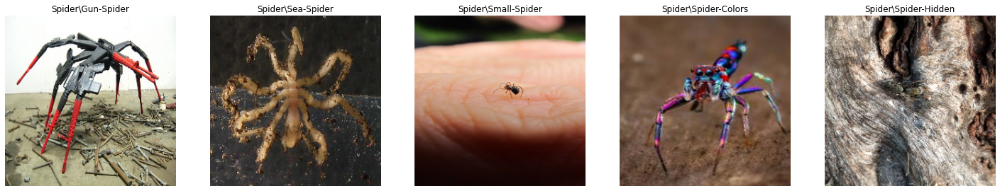

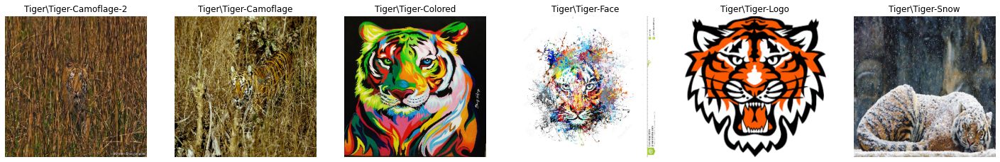

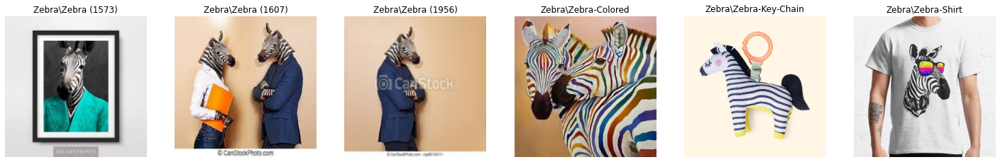

In [15]:
path = 'S:/Desktop/TrainingAnimalClassification/data/Interesting_Data/'
interesting_images = [glob(path + name + "/*") for name in class_names]

# Interesting Cat Images

for name in class_names:
    plt.figure(figsize=(25, 8))
    cat_interesting = interesting_images[class_names.index(name)]
    for i, i_path in enumerate(cat_interesting):
        name = i_path.split("/")[-1].split(".")[0]
        image = load_image(i_path)
        plt.subplot(1,len(cat_interesting),i+1)
        show_image(image, title=name.title())
    plt.show()

In [ ]:
with tf.device("/GPU:0"):
    ## Pre-Trained Model 
    base_model = ResNet50V2(input_shape=(256,256,3), include_top=False)
    base_model.trainable = False
    cls()

    # Model Architecture
    name = "ResNet50V2"
    model = Sequential([
        base_model,
        GAP(),
        Dense(256, activation='relu', kernel_initializer='he_normal'),
        Dropout(0.2),
        Dense(n_classes, activation='softmax')
    ], name=name)

    # Callbacks
    cbs = [EarlyStopping(patience=3, restore_best_weights=True), ModelCheckpoint(name + ".h5", save_best_only=True)]

    # Model 
    opt = tf.keras.optimizers.Adam(learning_rate=2e-3)
    model.compile(loss='sparse_categorical_crossentropy', optimizer=opt, metrics=['accuracy'])

    # Model Training
    history = model.fit(train_ds, validation_data=valid_ds, callbacks=cbs, epochs=1)

In [17]:
data = pd.DataFrame(history.history)

In [18]:
model = load_model('S:/Desktop/TrainingAnimalClassification/V3Resnet50.h5')
model.summary()

Model: "V3Resnet50"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50v2 (Functional)     (None, 8, 8, 2048)        23564800  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dense (Dense)               (None, 256)               524544    
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 15)                3855      
                                                                 
Total params: 24,093,199
Trainable params: 528,399
Non-trainable params: 23,564,800
______________________________________

In [19]:
model.evaluate(test_ds)

76/76 [==============================] - 136s 2s/step - loss: 0.2931 - accuracy: 0.9119


[0.29307788610458374, 0.9119235277175903]

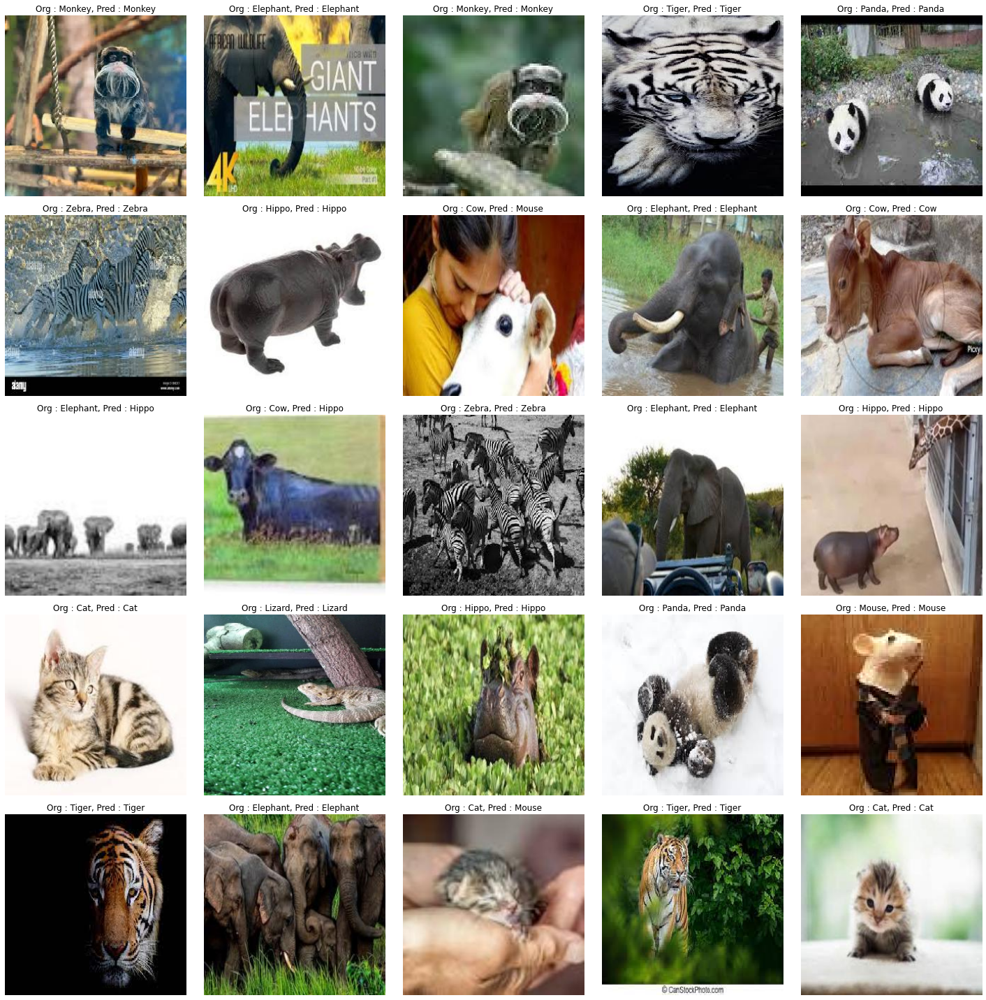

In [13]:
# Visualize Predictions
show_images(model=model, data=test_ds)

In [22]:
path = 'S:/Desktop/TrainingAnimalClassification/data/Interesting_Data'
interesting_images = [glob(path + name + "/*") for name in class_names]

# Interesting Cat Images

for name in class_names:
    plt.figure(figsize=(25, 8))
    cat_interesting = interesting_images[class_names.index(name)]
    for i, i_path in enumerate(cat_interesting):
        name = i_path.split("/")[-1].split(".")[0]
        image = load_image(i_path)
        plt.subplot(1,len(cat_interesting),i+1)
        
        # Model Prediction 
        org_class = name.title()
        preds = model.predict(image[np.newaxis,...])[0]
        pred_class = class_names[np.argmax(preds)]
        confidence_score = np.round(preds[np.argmax(preds)],2)
        
        
        # Configure Title
        title = f"Pred : {pred_class}\nConfidence : {confidence_score:.2}"
        
        show_image(image, title=title)
    plt.show()

<Figure size 1800x576 with 0 Axes>

<Figure size 1800x576 with 0 Axes>

<Figure size 1800x576 with 0 Axes>

<Figure size 1800x576 with 0 Axes>

<Figure size 1800x576 with 0 Axes>

<Figure size 1800x576 with 0 Axes>

<Figure size 1800x576 with 0 Axes>

<Figure size 1800x576 with 0 Axes>

<Figure size 1800x576 with 0 Axes>

<Figure size 1800x576 with 0 Axes>

<Figure size 1800x576 with 0 Axes>

<Figure size 1800x576 with 0 Axes>

<Figure size 1800x576 with 0 Axes>

<Figure size 1800x576 with 0 Axes>

<Figure size 1800x576 with 0 Axes>

In [ ]:
import numpy as np
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Lista de classes
class_names = [
    "Besouro", "Borboleta", "Gato", "Vaca", "Cachorro", "Elefante", 
    "Gorila", "Hipopótamo", "Lagarto", "Macaco", "Rato", "Panda", 
    "Aranha", "Tigre", "Zebra"
]

# Função para processar a imagem
def process_image(image_path, target_size=(256, 256)):
    """
    Carrega e processa uma imagem para classificação.
    
    Parâmetros:
        - image_path (str): Caminho para a imagem.
        - target_size (tuple): Dimensões para redimensionar a imagem (altura, largura).
    
    Retorna:
        - img_tensor (numpy.ndarray): Tensor da imagem processada.
    """
    # Carrega e redimensiona a imagem
    img = load_img(image_path, target_size=target_size)
    
    # Converte a imagem para um array e normaliza os valores para [0, 1]
    img_array = img_to_array(img) / 255.0
    
    # Adiciona uma dimensão extra para corresponder ao formato esperado pelo modelo
    img_tensor = np.expand_dims(img_array, axis=0)
    
    return img_tensor

# Caminho para a imagem
image_path = 'processImage.jpg'

# Carregar e processar a imagem
image_tensor = process_image(image_path)

# Carregar o modelo treinado
model = load_model('ResNet50V2.h5')

# Fazer a predição
predictions = model.predict(image_tensor)

# Obter o índice da classe com maior probabilidade
predicted_index = np.argmax(predictions)

# Obter o rótulo correspondente
predicted_label = class_names[predicted_index]

# Exibir o resultado
print(f"Animal classificado: {predicted_label}")


<class 'list'>


UnicodeDecodeError: 'utf-8' codec can't decode byte 0xe7 in position 34: invalid continuation byte